In [1]:
import scvelo as scv
import scanpy as sc
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity
import sys
import cell2location
from transpa.util import expVeloImp, leiden_cluster
import torch
import warnings
from transpa import expDeconv

warnings.filterwarnings('ignore')

seed = 10
device = torch.device("cuda:3") if torch.cuda.is_available() else torch.device("cpu")
# load preprocessed scRNA-seq and spatial datasets
RNA = scv.read('../data/Mouse_brain/RNA_adata.h5ad')
HybISS = scv.read('../data/Mouse_brain/HybISS_adata.h5ad')
RNA, HybISS

Global seed set to 0


(AnnData object with n_obs × n_vars = 40733 × 16907
     obs: 'CellID', 'Age', 'Region', 'Tissue', 'Class', 'Subclass', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts'
     var: 'GeneName', 'gene_count_corr'
     layers: 'spliced', 'unspliced',
 AnnData object with n_obs × n_vars = 4628 × 119
     obs: 'n_counts'
     var: 'GeneName'
     obsm: 'X_xy_loc', 'xy_loc')

In [2]:
RNA.obs

,CellID,Age,Region,Tissue,Class,Subclass,initial_size_spliced,initial_size_unspliced,initial_size,n_counts
0,10X40_3_A_1:CGAGGCACTAGAGAx,e11.0,Hindbrain,Hindbrain,Gastrulation,Cardiac mesoderm,2691,552,3460.0,993352.6250
1,10X40_3_A_1:TGTTAAGATCTCTAx,e11.0,Hindbrain,Hindbrain,Gastrulation,Cardiac mesoderm,3952,934,5182.0,988035.4375
2,10X40_3_A_1:GGAACTTGCTAGCAx,e11.0,Hindbrain,Hindbrain,Gastrulation,Cardiac mesoderm,3007,923,4222.0,990525.7500
3,10X40_3_A_1:CAGGTTGATGAAGAx,e11.0,Hindbrain,Hindbrain,Gastrulation,Cardiac mesoderm,3322,958,4572.0,986876.6250
4,10X25_5_A_1:AAATCCCTCTTAGGx,e10.0,Forebrain,Forebrain,Gastrulation,Osteochondral mesoderm,4071,656,5070.0,997436.0000
...,...,...,...,...,...,...,...,...,...,...
40728,10X40_6_A_1:ATCGGTGATTCAGGx,e11.0,Midbrain,Midbrain,Neuron,Diencephalon glutamatergic,1330,660,2193.0,996352.0000
40729,10X27_7_A_1:CCTCTACTCTTCCGx,e11.0,Forebrain,Forebrain,Neuron,Diencephalon glutamatergic,2347,829,3444.0,997677.1250
40730,10X27_7_A_1:CGTTAGGAATGCTGx,e11.0,Forebrain,Forebrain,Neuron,Diencephalon glutamatergic,1968,1050,3230.0,994117.6875
40731,10X27_7_A_1:ATCTGGGAGTCACAx,e11.0,Forebrain,Forebrain,Neuron,Diencephalon glutamatergic,742,529,1360.0,995588.2500


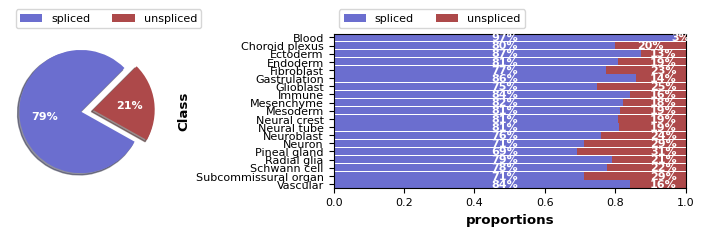

Extracted 2031 highly variable genes.


In [3]:
scv.pl.proportions(RNA, 'Class')
scv.pp.filter_and_normalize(RNA, n_top_genes=2000, retain_genes=HybISS.var_names)

# scv.pp.moments(RNA, n_pcs=30, n_neighbors=30)
# sc.tl.umap(RNA)
# scv.tl.velocity(RNA, vkey='stc_velocity', mode="stochastic")
# scv.tl.velocity_graph(RNA, vkey='stc_velocity', n_jobs=10)
# scv.tl.velocity_confidence(RNA, vkey='stc_velocity')

computing neighbors
    finished (0:00:41) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:14) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:01:14) --> added 
    'stc_velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 10/40 cores)


  0%|          | 0/40733 [00:00<?, ?cells/s]

    finished (0:03:06) --> added 
    'stc_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:23) --> added
    'stc_velocity_umap', embedded velocity vectors (adata.obsm)


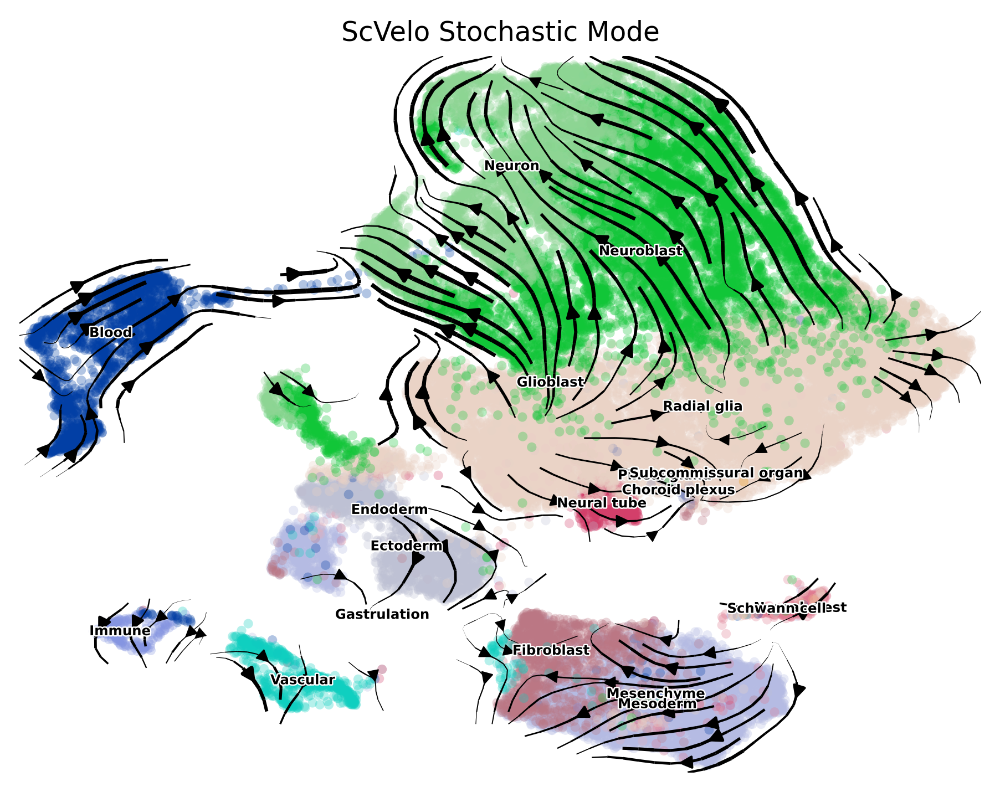

In [4]:
scv.pp.moments(RNA, n_pcs=30, n_neighbors=30)
sc.tl.umap(RNA)
scv.tl.velocity(RNA, vkey='stc_velocity', mode="stochastic")
scv.tl.velocity_graph(RNA, vkey='stc_velocity', n_jobs=10)
scv.pl.velocity_embedding_stream(RNA,  
                                vkey="stc_velocity", 
                                basis='X_umap', color="Class",
                                legend_fontsize=5,
                                size=50,
                                # legend_loc='right',
                                dpi=350, 
                                title='ScVelo Stochastic Mode')

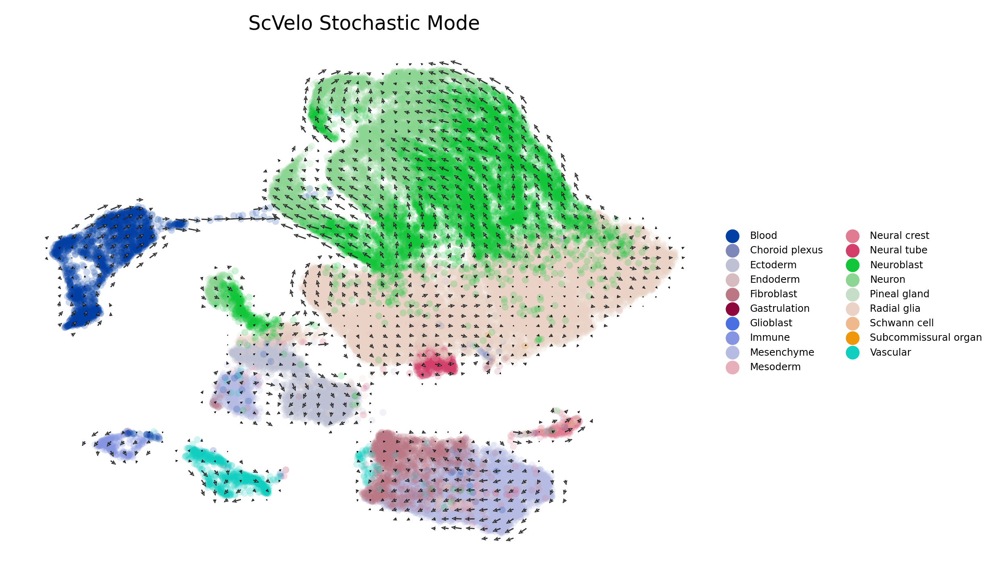

In [5]:
scv.pl.velocity_embedding_grid(RNA,  
                                vkey="stc_velocity", 
                                basis='X_umap', color="Class",
                                legend_fontsize=5,
                                size=50,
                                legend_loc='right',
                                arrow_length=2,
                                dpi=350, 
                                title='ScVelo Stochastic Mode')

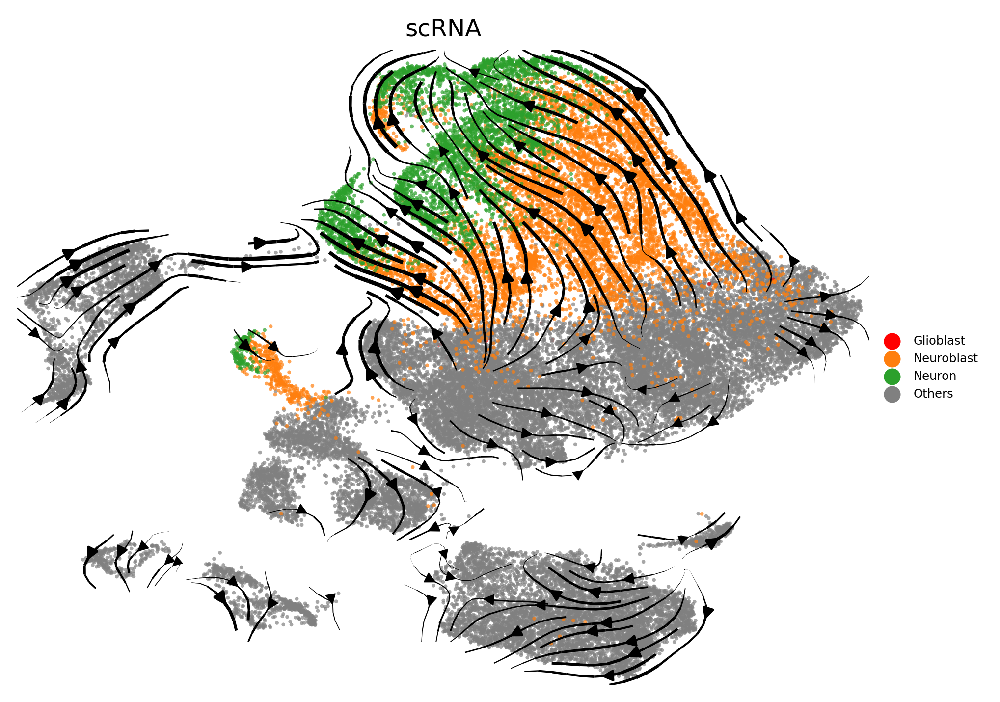

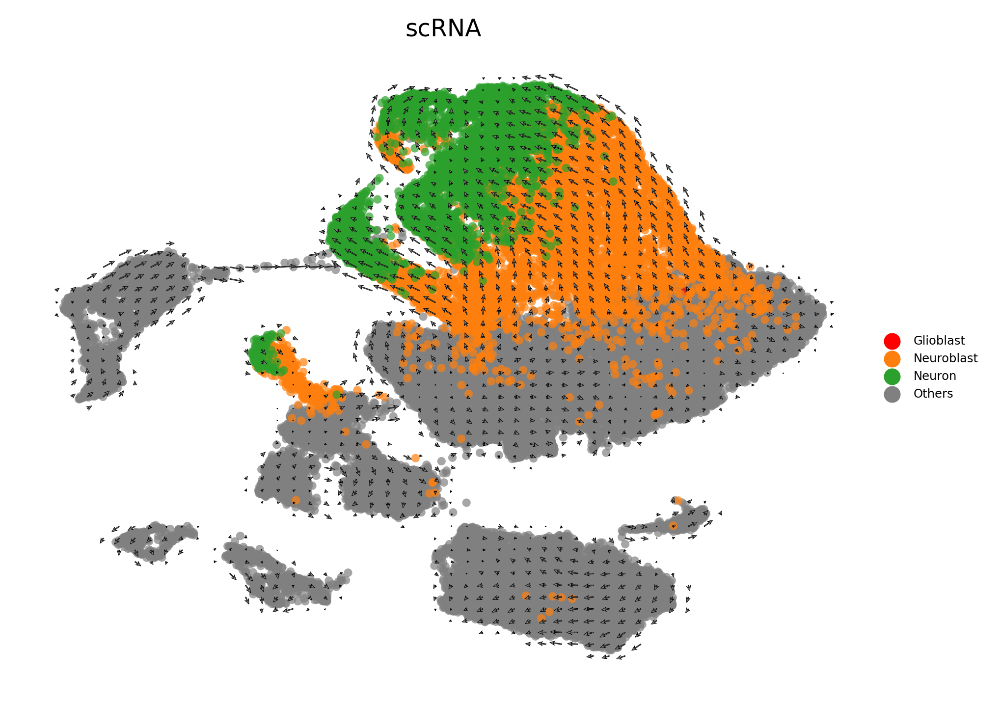

In [6]:
RNA.obs["Class_agg"] = list(map(lambda x: x if x in {"Neuron", "Glioblast", "Neuroblast"} else "Others", RNA.obs.Class.values))
RNA.uns['Class_agg_colors'] = ['#ff0000', '#ff7f0e', '#2ca02c', '#808080']
scv.pl.velocity_embedding_stream(RNA,  
                                vkey="stc_velocity", 
                                basis='X_umap', color="Class_agg",
                                legend_fontsize=5,
                                size=10,
                                legend_loc='right',
                                alpha=.7,
                                dpi=350, 
                                title='scRNA')

scv.pl.velocity_embedding_grid(RNA,  
                                vkey="stc_velocity", 
                                basis='X_umap', color="Class_agg",
                                legend_fontsize=5,
                                size=50,
                                alpha=.7,
                                arrow_length=2,
                                legend_loc='right',
                                dpi=350, 
                                title='scRNA')                                

In [7]:
RNA

AnnData object with n_obs × n_vars = 40733 × 2031
    obs: 'CellID', 'Age', 'Region', 'Tissue', 'Class', 'Subclass', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'stc_velocity_self_transition', 'Class_agg'
    var: 'GeneName', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'stc_velocity_gamma', 'stc_velocity_qreg_ratio', 'stc_velocity_r2', 'stc_velocity_genes'
    uns: 'pca', 'neighbors', 'umap', 'stc_velocity_params', 'stc_velocity_graph', 'stc_velocity_graph_neg', 'Class_colors', 'Class_agg_colors'
    obsm: 'X_pca', 'X_umap', 'stc_velocity_umap'
    varm: 'PCs'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'stc_velocity', 'variance_stc_velocity'
    obsp: 'distances', 'connectivities'

In [8]:
sc.pp.pca(HybISS, n_comps=30)
celltype_counts = RNA.obs['Class'].value_counts()

celltype_drop = celltype_counts.index[celltype_counts < 2]
rna_adata = RNA.copy()
if len(celltype_drop):
    print(f'Drop celltype {list(celltype_drop)} contain less 2 sample')
    rna_adata = RNA[~RNA.obs['Class'].isin(celltype_drop),].copy()
sc.tl.rank_genes_groups(rna_adata, groupby="Class", use_raw=False)
markers_df = pd.DataFrame(rna_adata.uns["rank_genes_groups"]["names"]).iloc[0:100, :]
# print(markers_df)
genes_sc = np.unique(markers_df.melt().value.values)

gene = np.intersect1d(genes_sc, HybISS.var_names)
rna_adata = rna_adata[:, gene].copy()
spa_adata = HybISS[:, gene].copy()

df_ref = pd.DataFrame(rna_adata.X, columns=rna_adata.var_names)
df_tgt = pd.DataFrame(spa_adata.X, columns=spa_adata.var_names)

shared_gene = np.intersect1d(df_ref.columns, df_tgt.columns)
df_ref = df_ref[shared_gene]
df_tgt = df_tgt[shared_gene]
classes = rna_adata.obs.Class.values
ct_list = np.unique(classes)    

preds, weight = expDeconv(
            df_ref=df_ref, 
            df_tgt=df_tgt, 
            classes=classes,
            ct_list=ct_list,
            n_epochs=8000,
            lr=1e-2,
            seed=seed,
            device=device
            ) 

cmps = weight

df_results = pd.DataFrame(cmps, columns=ct_list)
# mask = np.zeros(df_results.shape)
# for i, cols in enumerate(np.argsort(df_results.values, axis=1)[range(df_results.shape[0]), -int(3):]):
#     mask[i, cols] = 1
# df_results = pd.DataFrame(df_results.values * mask, columns=ct_list) 
df_results = (df_results.T/df_results.sum(axis=1)).T
HybISS.obs['Class'] = df_results.columns[np.argmax(df_results.values, axis=1)]

[LinTrans] Epoch: 8000/8000, loss: 1.000454: 100%|██████████| 8000/8000 [01:58<00:00, 67.70it/s] 


In [9]:
import tangram as tg
# classes, ct_list = leiden_cluster(rna_adata, False)
# cls_key = 'leiden'
# rna_adata.obs[cls_key] = classes
tg.pp_adatas(rna_adata, spa_adata, gene)
ad_map = tg.map_cells_to_space(rna_adata, spa_adata, mode='clusters', cluster_label='Class', device=device)
tg.project_cell_annotations(ad_map, spa_adata, annotation='Class')
HybISS.obs['tangram_ct_pred'] = spa_adata.obsm['tangram_ct_pred'].columns[np.argmax(spa_adata.obsm['tangram_ct_pred'].values, axis=1)]

INFO:root:50 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:50 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 50 genes and rna_count_based density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.271, KL reg: 0.215
Score: 0.501, KL reg: 0.003
Score: 0.503, KL reg: 0.002
Score: 0.503, KL reg: 0.002
Score: 0.503, KL reg: 0.002
Score: 0.504, KL reg: 0.002
Score: 0.504, KL reg: 0.002
Score: 0.504, KL reg: 0.002
Score: 0.504, KL reg: 0.002
Score: 0.504, KL reg: 0.002


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [10]:
# import scvi
# from scvi.data import register_tensor_from_anndata
# from scvi.external import RNAStereoscope, SpatialStereoscope
np.unique(HybISS.obs['Class'], return_counts=True), np.unique(HybISS.obs['tangram_ct_pred'], return_counts=True)

((array(['Blood', 'Choroid plexus', 'Ectoderm', 'Endoderm', 'Fibroblast',
         'Gastrulation', 'Glioblast', 'Immune', 'Mesenchyme', 'Mesoderm',
         'Neural crest', 'Neural tube', 'Neuroblast', 'Neuron',
         'Pineal gland', 'Radial glia', 'Schwann cell',
         'Subcommissural organ', 'Vascular'], dtype=object),
  array([337,  15, 486,  28, 307,  51,  39, 115, 565,  61, 176, 260, 783,
         607,  12, 548,  28,   4, 206])),
 (array(['Blood', 'Choroid plexus', 'Ectoderm', 'Endoderm', 'Fibroblast',
         'Gastrulation', 'Glioblast', 'Immune', 'Mesenchyme', 'Mesoderm',
         'Neural crest', 'Neural tube', 'Neuroblast', 'Neuron',
         'Pineal gland', 'Radial glia', 'Schwann cell',
         'Subcommissural organ', 'Vascular'], dtype=object),
  array([328,  34, 374,   4, 287,  14,   8, 136, 551,  22, 169, 230, 992,
         565,   8, 682,  11,   3, 210])))

In [11]:
np.unique(RNA.obs.Class, return_counts=True)

(array(['Blood', 'Choroid plexus', 'Ectoderm', 'Endoderm', 'Fibroblast',
        'Gastrulation', 'Glioblast', 'Immune', 'Mesenchyme', 'Mesoderm',
        'Neural crest', 'Neural tube', 'Neuroblast', 'Neuron',
        'Pineal gland', 'Radial glia', 'Schwann cell',
        'Subcommissural organ', 'Vascular'], dtype=object),
 array([ 2098,    18,  1948,     5,  1277,    15,    18,   230,  5332,
           61,   305,   550,  8369,  4302,     3, 15544,     8,     2,
          648]))

In [12]:
# scv.pl.velocity_embedding_stream(RNA,  
#                                 vkey="stc_velocity", 
#                                 basis='X_umap', color="Class",
#                                 dpi=150, 
#                                 title='ScVelo Stochastic Mode')
RNA

AnnData object with n_obs × n_vars = 40733 × 2031
    obs: 'CellID', 'Age', 'Region', 'Tissue', 'Class', 'Subclass', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'stc_velocity_self_transition', 'Class_agg'
    var: 'GeneName', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'stc_velocity_gamma', 'stc_velocity_qreg_ratio', 'stc_velocity_r2', 'stc_velocity_genes'
    uns: 'pca', 'neighbors', 'umap', 'stc_velocity_params', 'stc_velocity_graph', 'stc_velocity_graph_neg', 'Class_colors', 'Class_agg_colors'
    obsm: 'X_pca', 'X_umap', 'stc_velocity_umap'
    varm: 'PCs'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'stc_velocity', 'variance_stc_velocity'
    obsp: 'distances', 'connectivities'

In [13]:
import squidpy as sq
HybISS.obsm['spatial'] = HybISS.obsm['X_xy_loc']
sq.gr.spatial_neighbors(HybISS, coord_type='generic', n_neighs=10)


In [14]:
# HybISS = HybISS[:, np.intersect1d(HybISS.var_names, RNA.var_names)]
HybISS

AnnData object with n_obs × n_vars = 4628 × 119
    obs: 'n_counts', 'Class', 'tangram_ct_pred'
    var: 'GeneName'
    uns: 'pca', 'spatial_neighbors'
    obsm: 'X_xy_loc', 'xy_loc', 'X_pca', 'spatial'
    varm: 'PCs'
    obsp: 'spatial_connectivities', 'spatial_distances'

In [15]:
import pandas as pd
raw_spatial_df  = pd.DataFrame(HybISS.X, columns=HybISS.var_names)
raw_scrna_df    = pd.DataFrame(RNA.X, columns=RNA.var_names).astype(pd.SparseDtype("float32", 0))
raw_shared_gene = np.intersect1d(raw_spatial_df.columns, raw_scrna_df.columns)
raw_spatial_df.shape, raw_scrna_df.shape, raw_shared_gene.shape

((4628, 119), (40733, 2031), (117,))

In [16]:
RNA

AnnData object with n_obs × n_vars = 40733 × 2031
    obs: 'CellID', 'Age', 'Region', 'Tissue', 'Class', 'Subclass', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'stc_velocity_self_transition', 'Class_agg'
    var: 'GeneName', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'stc_velocity_gamma', 'stc_velocity_qreg_ratio', 'stc_velocity_r2', 'stc_velocity_genes'
    uns: 'pca', 'neighbors', 'umap', 'stc_velocity_params', 'stc_velocity_graph', 'stc_velocity_graph_neg', 'Class_colors', 'Class_agg_colors'
    obsm: 'X_pca', 'X_umap', 'stc_velocity_umap'
    varm: 'PCs'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'stc_velocity', 'variance_stc_velocity'
    obsp: 'distances', 'connectivities'

In [17]:
S, U, V, X = expVeloImp(
            df_ref=raw_scrna_df,
            df_tgt=raw_spatial_df,
            S=RNA.layers['spliced'],
            U=RNA.layers['unspliced'],
            V=RNA.layers['spliced'],
            train_gene=raw_shared_gene,
            test_gene=RNA.var_names,
            signature_mode='cell',
            mapping_mode='lowrank', 
            spa_adj=HybISS.obsp['spatial_connectivities'].tocoo(),
            n_epochs=1000,
            seed=seed,
            device=device)

[TransImp] Epoch: 1000/1000, loss: 0.645143, (IMP) 0.638101, (SPA) 1.0 x 0.007043: 100%|██████████| 1000/1000 [00:13<00:00, 75.19it/s]


Normalized count data: X, spliced, unspliced.


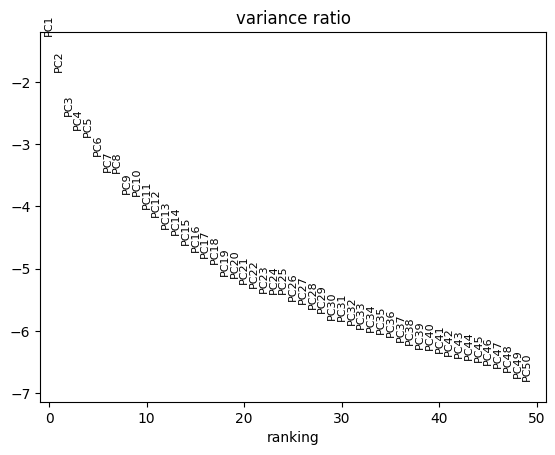

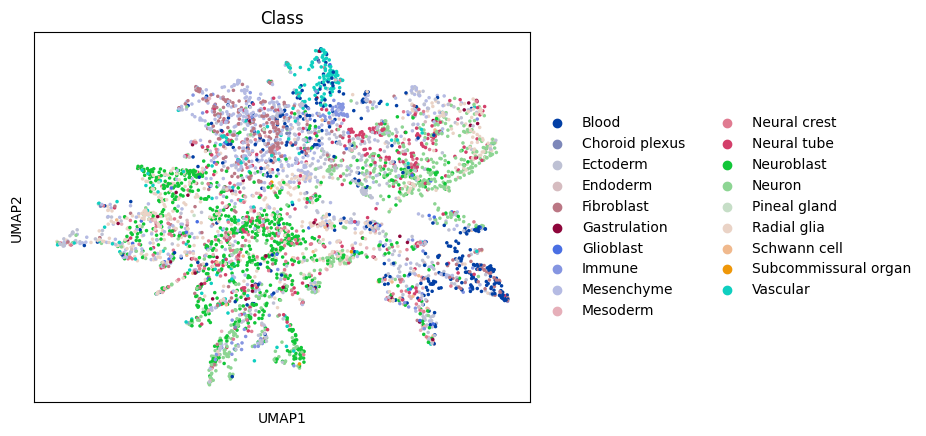

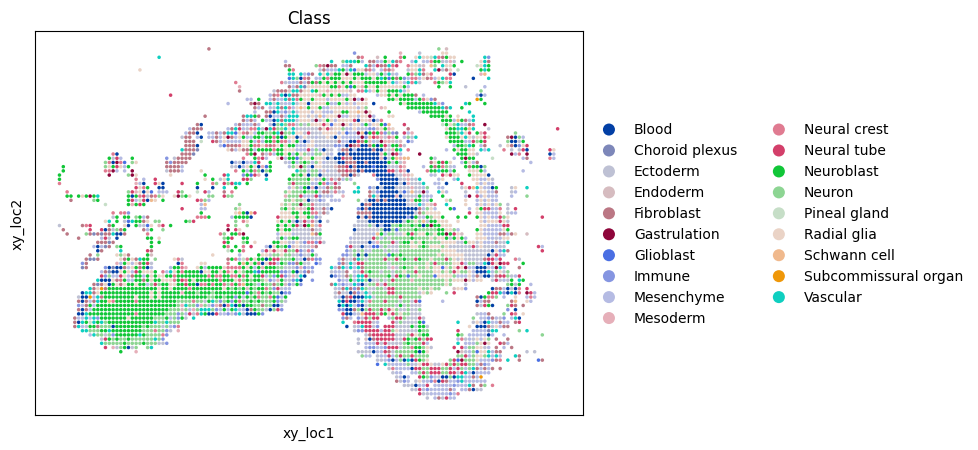

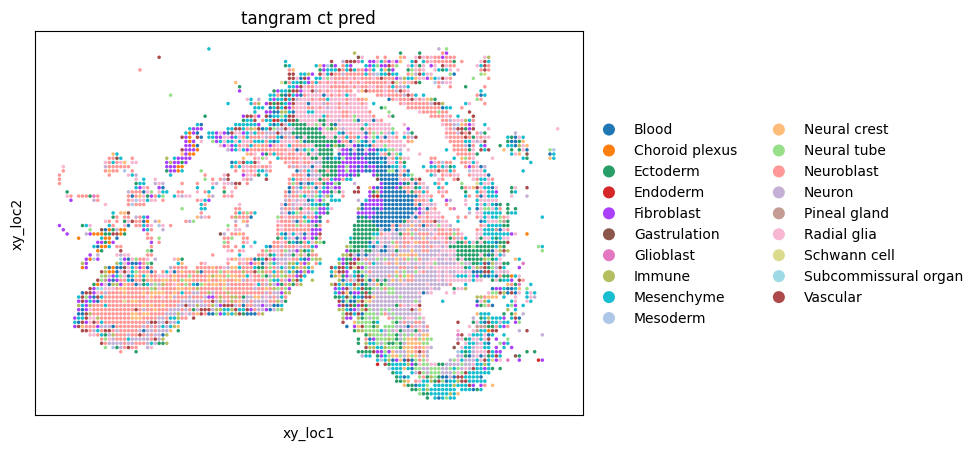

computing moments based on connectivities
    finished (0:00:04) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:05) --> added 
    'stc_velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 10/40 cores)


  0%|          | 0/4628 [00:00<?, ?cells/s]

    finished (0:00:19) --> added 
    'stc_velocity_graph', sparse matrix with cosine correlations (adata.uns)
--> added 'stc_velocity_length' (adata.obs)
--> added 'stc_velocity_confidence' (adata.obs)
--> added 'stc_velocity_confidence_transition' (adata.obs)


In [18]:
imp_adata = sc.AnnData(X)
imp_adata.obs = HybISS.obs.copy()
imp_adata.obsm = HybISS.obsm.copy()
imp_adata.var_names = RNA.var_names
imp_adata.obs_names = HybISS.obs_names
imp_adata.uns = HybISS.uns
imp_adata.uns['Class_colors'] = RNA.uns['Class_colors']

imp_adata.layers['spliced'] = S
imp_adata.layers['unspliced'] = U
# imp_adata.layers['velocity'] = V

scv.pp.normalize_per_cell(imp_adata, enforce=True)
sc.pp.scale(imp_adata)
sc.tl.pca(imp_adata)
sc.pl.pca_variance_ratio(imp_adata, n_pcs=50, log=True)
sc.pp.neighbors(imp_adata, n_neighbors=30, n_pcs=30)
sc.tl.umap(imp_adata)
sc.tl.leiden(imp_adata)
sc.pl.umap(imp_adata, color='Class')
sc.pl.scatter(imp_adata, basis='xy_loc',color='Class')
sc.pl.scatter(imp_adata, basis='xy_loc',color='tangram_ct_pred')



scv.pp.moments(imp_adata, n_pcs=30, n_neighbors=30)
scv.tl.velocity(imp_adata, vkey='stc_velocity')
scv.tl.velocity_graph(imp_adata, vkey='stc_velocity', n_jobs=10)
scv.tl.velocity_confidence(imp_adata, vkey='stc_velocity')

computing velocity embedding
    finished (0:00:02) --> added
    'stc_velocity_umap', embedded velocity vectors (adata.obsm)


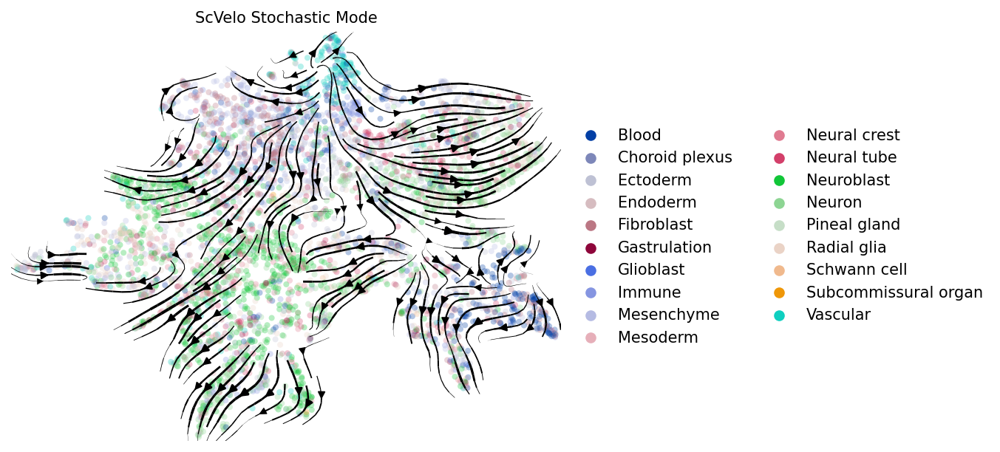

In [19]:
scv.pl.velocity_embedding_stream(imp_adata,  
                                vkey="stc_velocity", 
                                basis='X_umap', color="Class",
                                # legend_fontsize=2,
                                size=60,
                                legend_loc='right',
                                dpi=150, 
                                title='ScVelo Stochastic Mode')

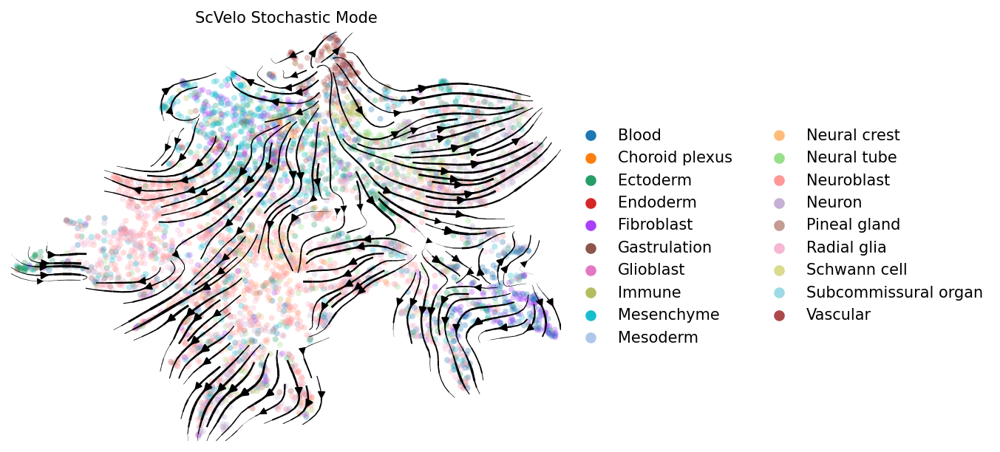

In [20]:
scv.pl.velocity_embedding_stream(imp_adata,  
                                vkey="stc_velocity", 
                                basis='X_umap', color="tangram_ct_pred",
                                # legend_fontsize=2,
                                size=60,
                                legend_loc='right',
                                dpi=150, 
                                title='ScVelo Stochastic Mode')

computing velocity embedding
    finished (0:00:02) --> added
    'stc_velocity_xy_loc', embedded velocity vectors (adata.obsm)


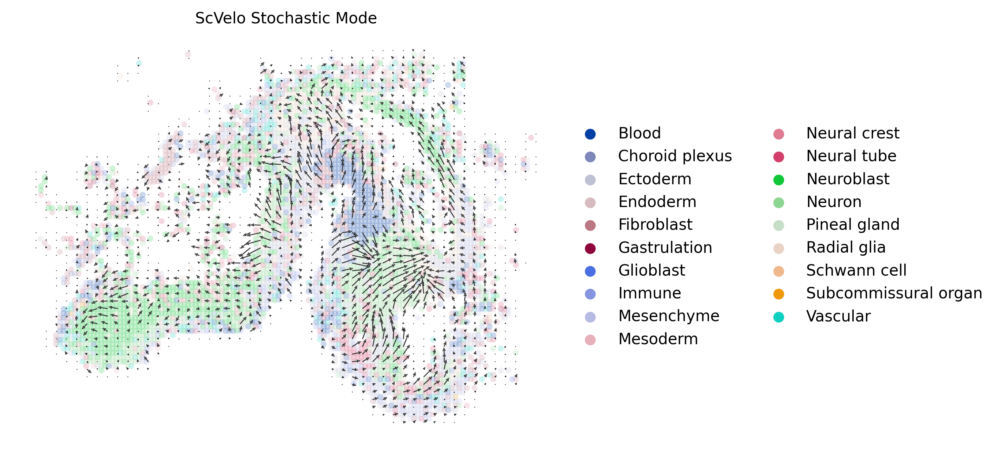

In [21]:
scv.pl.velocity_embedding_grid(imp_adata,  
                                vkey="stc_velocity", 
                                basis='xy_loc', color="Class",
                                # legend_fontsize=2,
                                size=60,
                                legend_loc='right',
                                # smooth=0.5,
                                dpi=350, 
                                title='ScVelo Stochastic Mode')

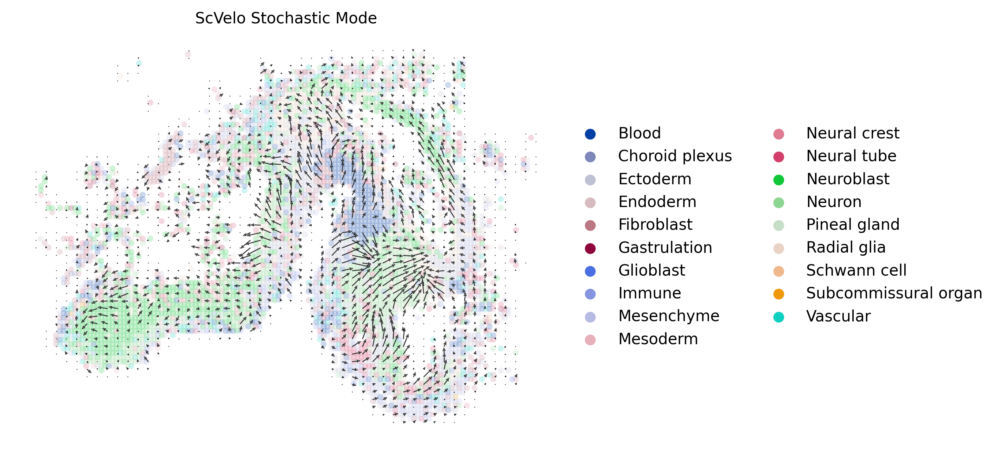

In [22]:
scv.pl.velocity_embedding_grid(imp_adata,  
                                vkey="stc_velocity", 
                                basis='xy_loc', color="Class",
                                # legend_fontsize=2,
                                size=60,
                                legend_loc='right',
                                # smooth=0.5,
                                dpi=350, 
                                title='ScVelo Stochastic Mode')

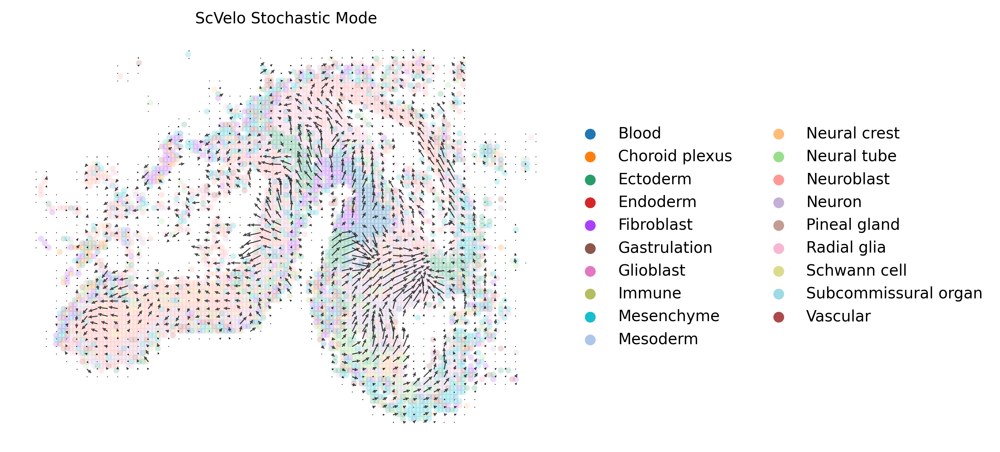

In [23]:
scv.pl.velocity_embedding_grid(imp_adata,  
                                vkey="stc_velocity", 
                                basis='xy_loc', color="tangram_ct_pred",
                                # legend_fontsize=2,
                                size=60,
                                legend_loc='right',
                                # smooth=0.5,
                                dpi=350, 
                                title='ScVelo Stochastic Mode')

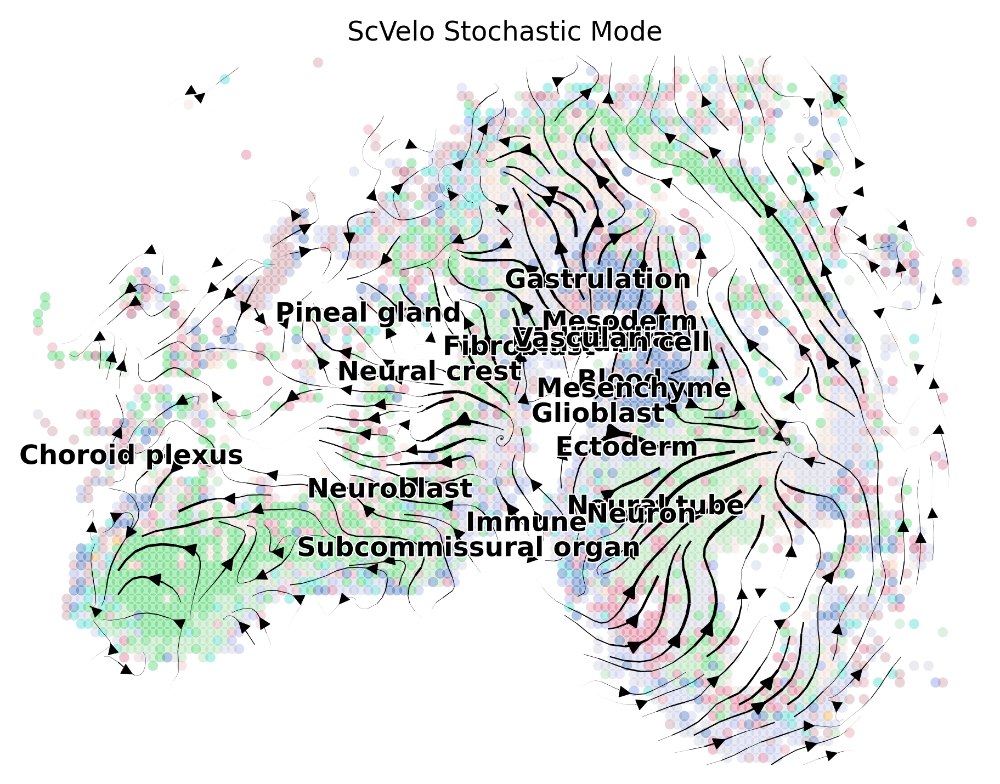

In [24]:
scv.pl.velocity_embedding_stream(imp_adata,  
                                vkey="stc_velocity", 
                                basis='xy_loc', color="Class",
                                # legend_fontsize=2,
                                size=60,
                                # legend_loc='right',
                                # smooth=0.5,
                                dpi=350, 
                                title='ScVelo Stochastic Mode')

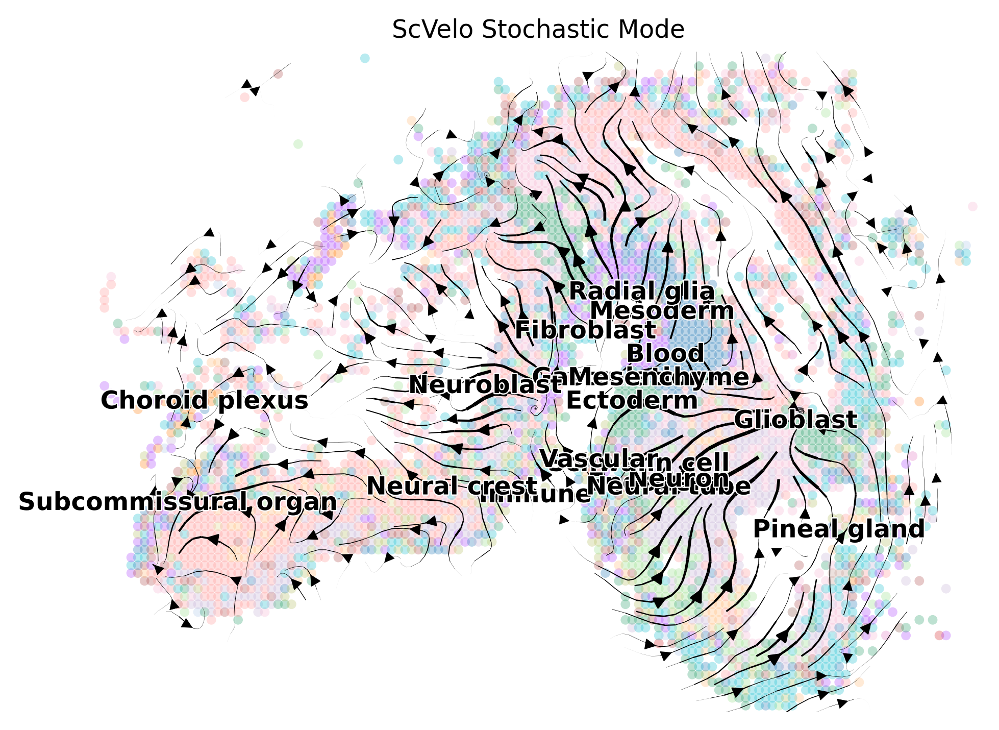

In [25]:
scv.pl.velocity_embedding_stream(imp_adata,  
                                vkey="stc_velocity", 
                                basis='xy_loc', color="tangram_ct_pred",
                                # legend_fontsize=2,
                                size=60,
                                # legend_loc='right',
                                # smooth=0.5,
                                dpi=350, 
                                title='ScVelo Stochastic Mode')

In [26]:
imp_adata.obs["Class_agg"] = list(map(lambda x: x if x in {"Neuron", "Glioblast", "Neuroblast"} else "Others", imp_adata.obs.Class.values))
imp_adata.uns['Class_agg_colors'] = ['#ff0000', '#ff7f0e', '#2ca02c', '#808080']
imp_adata.obs["tangram_ct_pred_agg"] = list(map(lambda x: x if x in {"Neuron", "Glioblast", "Neuroblast"} else "Others", imp_adata.obs.tangram_ct_pred.values))
imp_adata.uns['tangram_ct_pred_agg_colors'] = ['#ff0000', '#ff7f0e', '#2ca02c', '#808080']

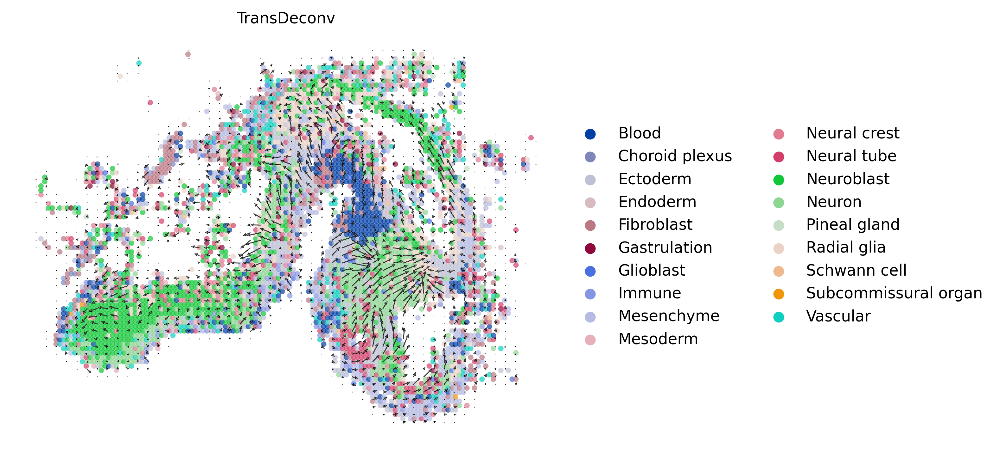

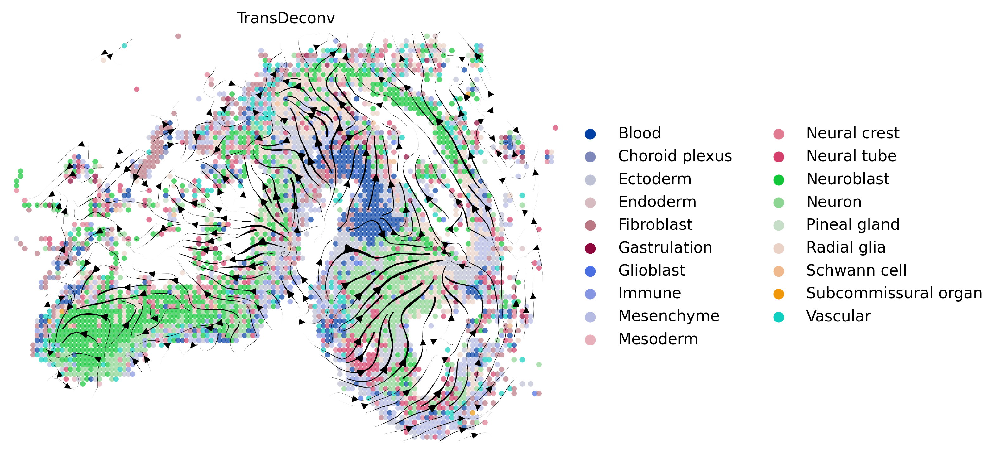

In [27]:

scv.pl.velocity_embedding_grid(imp_adata,  
                                vkey="stc_velocity", 
                                basis='xy_loc', color="Class",
                                # legend_fontsize=2,
                                size=50,
                                legend_loc='right',
                                alpha=.7,
                                # smooth=0.5,
                                dpi=350, 
                                title='TransDeconv')
scv.pl.velocity_embedding_stream(imp_adata,  
                                vkey="stc_velocity", 
                                basis='xy_loc', color="Class",
                                # legend_fontsize=2,
                                size=50,
                                legend_loc='right',
                                alpha=.7,
                                # smooth=0.5,
                                dpi=350, 
                                title='TransDeconv')                                

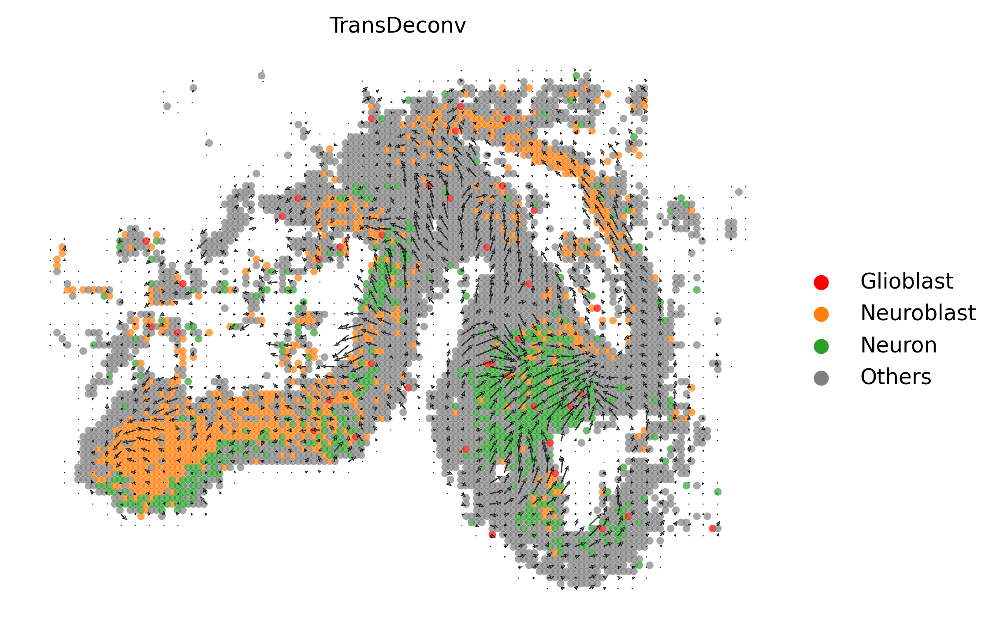

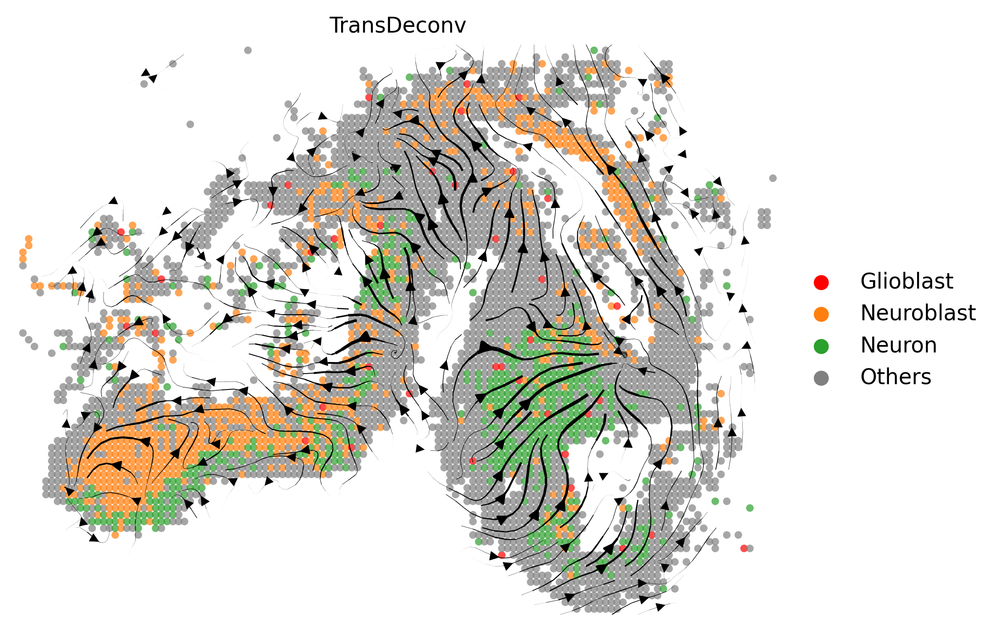

In [28]:

scv.pl.velocity_embedding_grid(imp_adata,  
                                vkey="stc_velocity", 
                                basis='xy_loc', color="Class_agg",
                                # legend_fontsize=2,
                                size=50,
                                legend_loc='right',
                                alpha=.7,
                                # smooth=0.5,
                                dpi=350, 
                                title='TransDeconv')
scv.pl.velocity_embedding_stream(imp_adata,  
                                vkey="stc_velocity", 
                                basis='xy_loc', color="Class_agg",
                                # legend_fontsize=2,
                                size=50,
                                legend_loc='right',
                                alpha=.7,
                                # smooth=0.5,
                                dpi=350, 
                                title='TransDeconv')                                